In [1]:
import pandas as pd
from pymongo import MongoClient

In [2]:
# Set connection
client = MongoClient("mongodb://localhost:27017/")
db = client["bank"]
balances_collection = db["balances"]

In [3]:
# Fetch balance evolution data from MongoDB
cursor = balances_collection.find({}, {"_id": 0})  # Exclude MongoDB item ID

data = list(cursor)
data

[{'date': '2017-01-01',
  'balances': {'0': {'balance': 96646.86},
   '1': {'balance': 80707.36},
   '2': {'balance': 52101.1},
   '3': {'balance': 90324.4},
   '4': {'balance': 91267.86},
   '5': {'balance': 77717.44},
   '6': {'balance': 69099.23},
   '7': {'balance': 97479.13},
   '8': {'balance': 98752.44},
   '9': {'balance': 88834.29},
   '10': {'balance': 92168.76},
   '11': {'balance': 81167.91},
   '12': {'balance': 73205.69},
   '13': {'balance': 98213.62},
   '14': {'balance': 55914.61},
   '15': {'balance': 55743.03},
   '16': {'balance': 50963.87},
   '17': {'balance': 93010.16},
   '18': {'balance': 92937.23},
   '19': {'balance': 78765.19},
   '20': {'balance': 72409.24},
   '21': {'balance': 93546.54},
   '22': {'balance': 94007.32},
   '23': {'balance': 99168.24},
   '24': {'balance': 53332.53},
   '25': {'balance': 98268.42},
   '26': {'balance': 55712.15},
   '27': {'balance': 73519.93},
   '28': {'balance': 69375.75},
   '29': {'balance': 85092.23},
   '30': {'balan

In [4]:
#df = pd.DataFrame([{**entry["balances"], "date": entry["date"]} for entry in data])

#print(df.shape) # must be (720, 1447)
#print(df.head())

#      | id1 | id2 | ... | id1446
# day1 |   
# day2 |        balances
# ...

In [5]:
#df

In [6]:
# Check the number of unique dates in extracted data
dates = [entry["date"] for entry in data]
print("Unique dates found:", len(set(dates)))  # Should be 720
print("First 5 dates:", sorted(set(dates))[:5])
print("Last 5 dates:", sorted(set(dates))[-5:])

Unique dates found: 720
First 5 dates: ['2017-01-01', '2017-01-02', '2017-01-03', '2017-01-04', '2017-01-05']
Last 5 dates: ['2018-12-17', '2018-12-18', '2018-12-19', '2018-12-20', '2018-12-21']


In [8]:
df = pd.DataFrame([
    {key: value["balance"] for key, value in entry["balances"].items()} | {"date": entry["date"]}
    for entry in data
])

# Convert "date" to datetime and set as index
df["date"] = pd.to_datetime(df["date"])
df.set_index("date", inplace=True)
df.sort_index(inplace=True)

In [8]:
df

,0,1,2,3,4,5,6,7,8,9,...,1436,1437,1438,1439,1440,1441,1442,1443,1444,1445
date,,,,,,,,,,,,,,,,,,,,,
2017-01-01,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2017-01-02,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2017-01-03,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2017-01-04,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2017-01-05,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-17,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2018-12-18,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2018-12-19,96646.86,80707.36,52101.1,90324.4,91267.86,77717.44,69099.23,97479.13,98752.44,88834.29,...,71078.19,95315.42,98761.26,50897.28,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22


/var/folders/s6/4jprwbqj4012tkll2ww6r5hr0000gq/T/ipykernel_3723/275894041.py:22: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


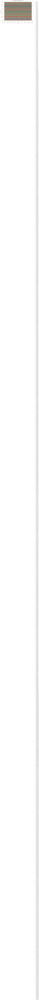

In [9]:
import matplotlib.pyplot as plt

# Plot the balance evolution for all users (columns) as separate lines
plt.figure(figsize=(12, 8))

# Plot each column (account balance) as a line
for user in df.columns:
    plt.plot(df.index, df[user], label=f"User {user}", alpha=0.6)

# Add title and labels
plt.title("Balance Evolution of Users Over Time")
plt.xlabel("Date")
plt.ylabel("Balance")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add legend to differentiate users
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()
plt.show()